In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('D:\multi_class\BrreakHIS_v1_200x_Binary\dataset'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-001.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-002.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-003.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-004.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-005.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-006.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-007.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-008.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-009.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-010.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-011.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-

In [2]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

import os
base_dir = 'D:\multi_class\BrreakHIS_v1_200x_Binary\dataset'
print(os.listdir(base_dir))

# Matplotlib for visualization
import matplotlib.pyplot as plt
plt.style.use("ggplot")

# OpenCV Image Library
import cv2

# Import PyTorch
import torchvision.transforms as transforms
from torch.utils.data.sampler import SubsetRandomSampler
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import TensorDataset, DataLoader, Dataset
import torchvision
import torch.optim as optim

# Import useful sklearn functions
import sklearn
from sklearn.metrics import roc_auc_score, accuracy_score
from PIL import Image

['benign', 'malignant']


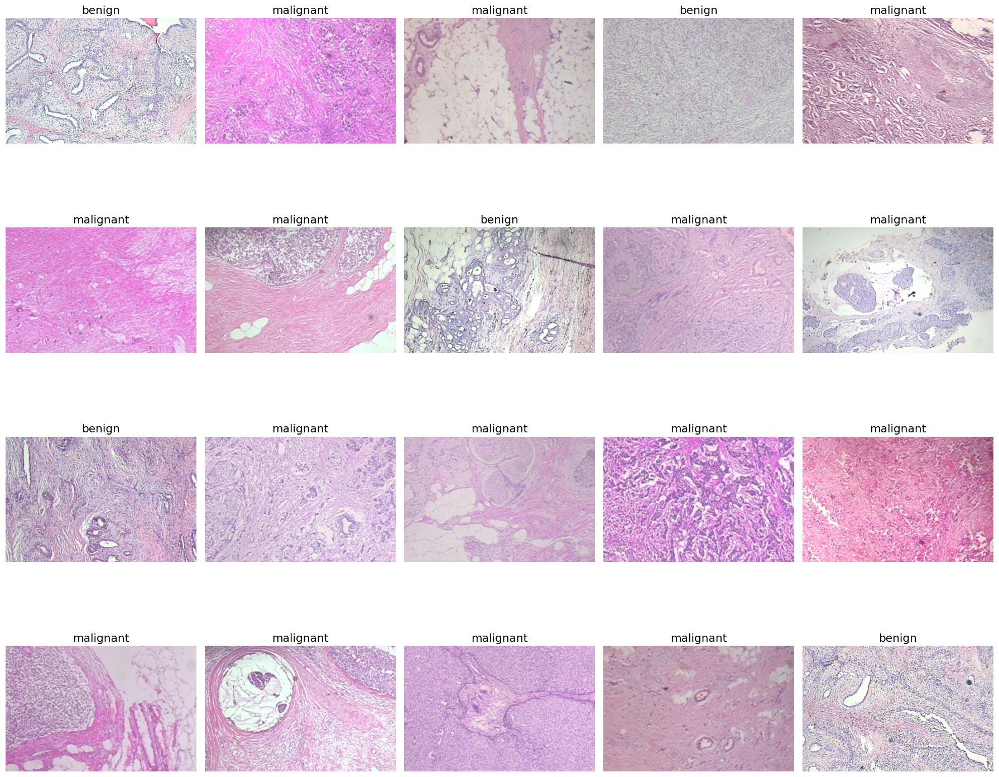

In [3]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

# Directory containing images
dataset_dir = 'D:\multi_class\BrreakHIS_v1_200x_Binary\dataset'

# Function to display random images from a directory
def show_random_images_from_directory(directory, num_images=10):
    # List all files in the directory
    image_files = []
    for root, _, files in os.walk(directory):
        for file in files:
            # Check if the file is an image
            if file.endswith('.png') or file.endswith('.jpg') or file.endswith('.jpeg'):
                # Construct the full path to the image
                img_path = os.path.join(root, file)
                image_files.append(img_path)
    
    # Randomly select num_images images
    random_images = random.sample(image_files, num_images)
    
    # Create subplots
    ncols = 5  # Number of columns for display
    nrows = (num_images + ncols - 1) // ncols  # Calculate number of rows based on number of images
    fig, axes = plt.subplots(nrows, ncols, figsize=(18, 4 * nrows))
    
    # Iterate over selected random images and display them
    for i, img_path in enumerate(random_images):
        ax = axes.flatten()[i]
        image = Image.open(img_path)
        ax.imshow(image)
        
        # Extract class name from the image path
        class_name = os.path.basename(os.path.dirname(img_path))
        ax.set_title(class_name)  # Display the class name as the title
        ax.axis('off')
    
    # Remove empty subplots
    for j in range(i + 1, nrows * ncols):
        axes.flatten()[j].remove()
    
    plt.tight_layout()
    plt.show()

# Display random 10 images from the dataset directory
show_random_images_from_directory(dataset_dir, num_images=20)


Found 1995 images in directory: D:\multi_class\BrreakHIS_v1_40x_Binary\dataset
Sample of image paths:
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-001.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-002.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-003.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-004.png
D:\multi_class\BrreakHIS_v1_40x_Binary\dataset\benign\SOB_B_A-14-22549AB-40-005.png


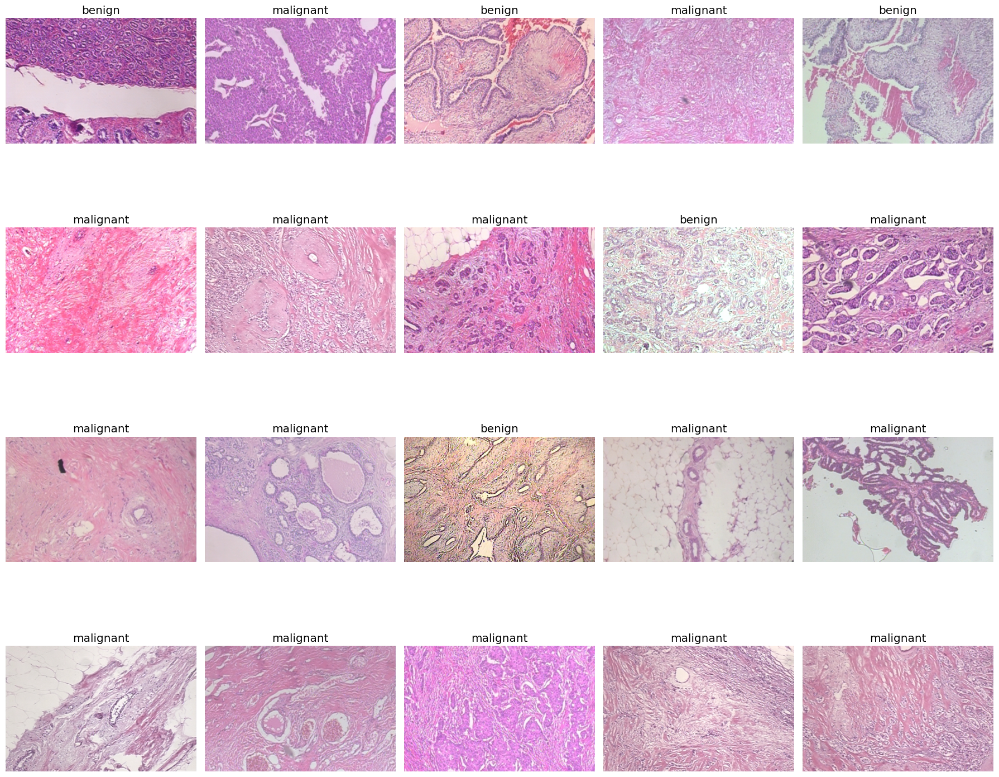

In [4]:
import os
import random
import matplotlib.pyplot as plt
from PIL import Image

# Directory containing images
dataset_dir = 'D:\multi_class\BrreakHIS_v1_200x_Binary\dataset'

# Function to display random images from a directory
def show_random_images_from_directory(directory, num_images=10):
    # List all files in the directory
    image_files = []
    for root, _, files in os.walk(directory):
        for file in files:
            # Check if the file is an image
            if file.endswith('.png') or file.endswith('.jpg') or file.endswith('.jpeg'):
                # Construct the full path to the image
                img_path = os.path.join(root, file)
                image_files.append(img_path)
    
    # Print the list of image files found (for debugging)
    print(f"Found {len(image_files)} images in directory: {directory}")
    print("Sample of image paths:")
    for img_path in image_files[:5]:  # Print the first 5 paths as an example
        print(img_path)
    
    # Randomly select num_images images
    random_images = random.sample(image_files, min(num_images, len(image_files)))
    
    # Create subplots
    ncols = 5  # Number of columns for display
    nrows = (len(random_images) + ncols - 1) // ncols  # Calculate number of rows based on number of images
    fig, axes = plt.subplots(nrows, ncols, figsize=(18, 4 * nrows))
    
    # Iterate over selected random images and display them
    for i, img_path in enumerate(random_images):
        ax = axes.flatten()[i]
        image = Image.open(img_path)
        ax.imshow(image)
        
        # Extract class name from the image path
        class_name = os.path.basename(os.path.dirname(img_path))
        ax.set_title(class_name)  # Display the class name as the title
        ax.axis('off')
    
    # Remove empty subplots
    for j in range(len(random_images), nrows * ncols):
        axes.flatten()[j].remove()
    
    plt.tight_layout()
    plt.show()

# Display random 20 images from the dataset directory
show_random_images_from_directory(dataset_dir, num_images=20)


Classes found in dataset:
['benign', 'malignant']
Class to index mapping:
{'benign': 0, 'malignant': 1}


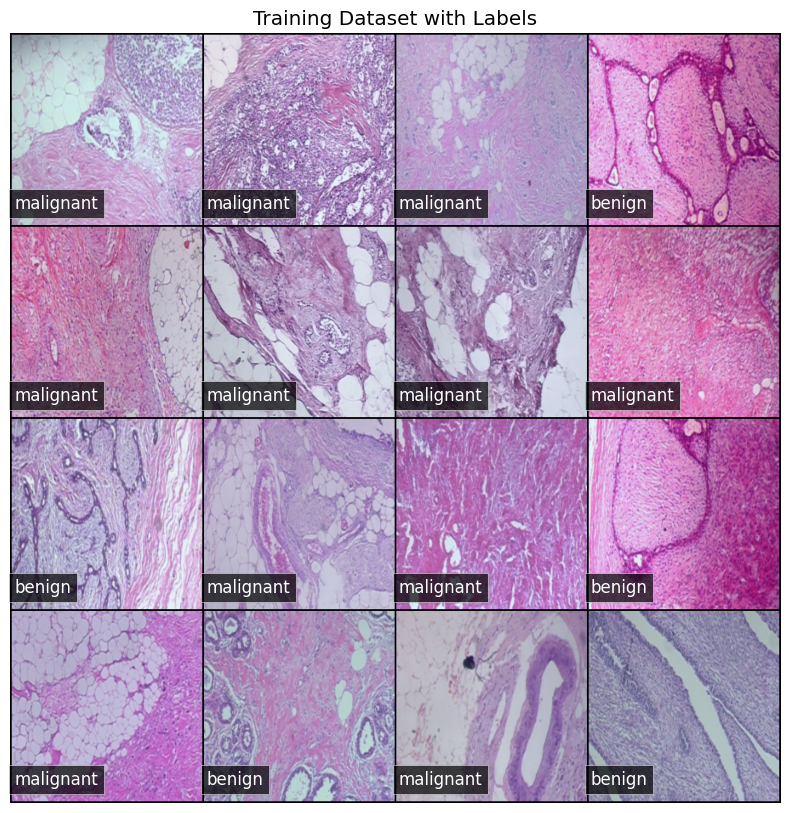

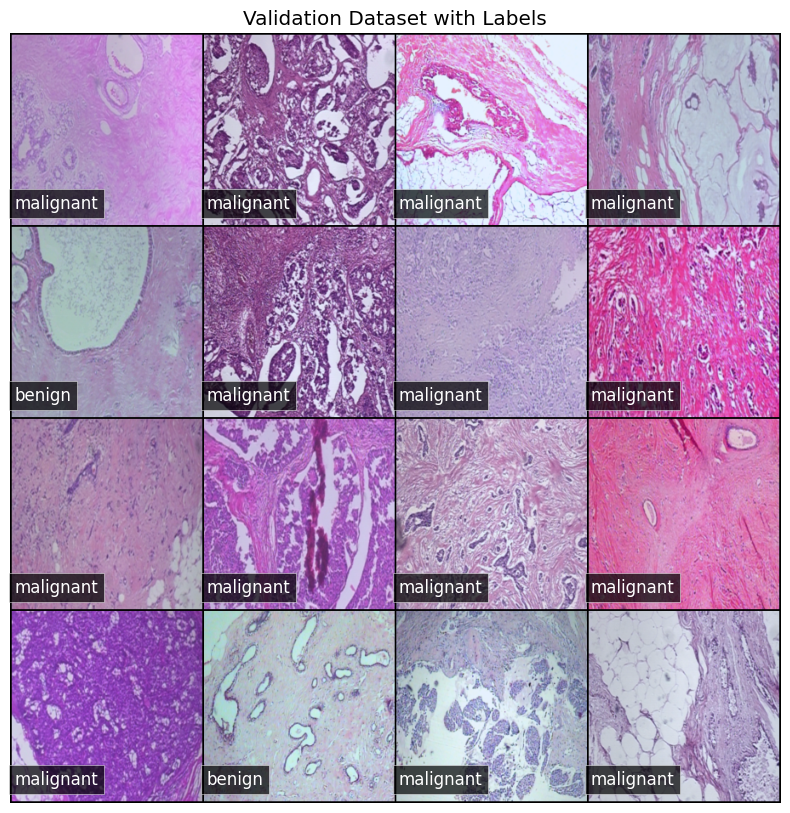

Training Phase:
Batch 0:
torch.Size([64, 3, 224, 224])
tensor([1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1,
        1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0,
        1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1], dtype=torch.int32)
Batch 1:
torch.Size([64, 3, 224, 224])
tensor([1, 0, 1, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1,
        1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1,
        1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1], dtype=torch.int32)
Batch 2:
torch.Size([64, 3, 224, 224])
tensor([0, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 1, 1, 0,
        1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0,
        1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1], dtype=torch.int32)
Batch 3:
torch.Size([64, 3, 224, 224])
tensor([1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1,
        1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1,

In [5]:
import torch
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision import transforms
from PIL import Image, ImageEnhance
import os
import numpy as np
import random
import cv2
import matplotlib.pyplot as plt
import torchvision.utils as vutils
from imblearn.over_sampling import RandomOverSampler

# Define custom transformations
class SpecificColorPopup:
    def __init__(self, probability=0.5, factor=2.5):
        self.probability = probability
        self.factor = factor

    def __call__(self, img):
        if random.random() < self.probability:
            img = self.enhance_specific_colors(img, self.factor)
        return img

    def enhance_specific_colors(self, img, factor):
        img_cv = np.array(img)
        img_cv = cv2.cvtColor(img_cv, cv2.COLOR_RGB2HSV)
        color_ranges = [
            ((140, 50, 50), (170, 255, 255)),  # Pink
            ((120, 50, 50), (140, 255, 255)),  # Purple
            ((100, 50, 50), (120, 255, 255)),  # Blue
            ((0, 50, 50), (10, 255, 255)),     # Red
            ((170, 50, 50), (180, 255, 255)),  # Red again
            ((80, 50, 50), (100, 255, 255))    # Greenish-blue
        ]
        for lower, upper in color_ranges:
            mask = cv2.inRange(img_cv, lower, upper)
            img_cv[mask > 0] = self.enhance_color(img_cv[mask > 0], factor)
        img_cv = cv2.cvtColor(img_cv, cv2.COLOR_HSV2RGB)
        return Image.fromarray(img_cv)

    def enhance_color(self, pixels, factor):
        pixels[:, 1] = np.clip(pixels[:, 1] * factor, 0, 255)
        return pixels

class EdgeSharpening:
    def __init__(self, factor=2.0):
        self.factor = factor

    def __call__(self, img):
        enhancer = ImageEnhance.Sharpness(img)
        img = enhancer.enhance(self.factor)
        return img

# Custom Dataset class
class CustomDataset(Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform
        
        # List all files in the dataset directory
        self.file_list = []
        for root, _, files in os.walk(self.data_dir):
            for file in files:
                if file.endswith('.png') or file.endswith('.jpg') or file.endswith('.jpeg'):
                    self.file_list.append(os.path.join(root, file))
        
        # Initialize an empty set to collect unique class names
        self.classes = set()
        
        # Populate self.classes
        for file_path in self.file_list:
            class_name = os.path.basename(os.path.dirname(file_path))
            self.classes.add(class_name)
        
        # Sort and convert set to list for consistency in class indexing
        self.classes = sorted(list(self.classes))
        
        # Create self.class_to_idx mapping
        self.class_to_idx = {cls: idx for idx, cls in enumerate(self.classes)}
        
        # Create a list of (file_path, label) tuples
        self.samples = [(file_path, self.class_to_idx[os.path.basename(os.path.dirname(file_path))]) for file_path in self.file_list]
        
        # Print class names and indices for verification
        print("Classes found in dataset:")
        print(self.classes)
        print("Class to index mapping:")
        print(self.class_to_idx)
        
    def __len__(self):
        return len(self.samples)
    
    def __getitem__(self, idx):
        img_path, label = self.samples[idx]
        image = Image.open(img_path).convert('RGB')
        
        if self.transform:
            image = self.transform(image)
        
        return image, label

# Define data directory and transformations
data_dir = 'D:\\multi_class\\BrreakHIS_v1_200x_Binary\\dataset'

# Define transformations for training set with additional augmentations
train_transform = transforms.Compose([
    SpecificColorPopup(probability=0.5, factor=2.5),
    EdgeSharpening(factor=2.0),
    transforms.RandomHorizontalFlip(),
    transforms.RandomRotation(10),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.2),
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Define transformations for validation set without augmentation
val_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create CustomDataset instances
dataset = CustomDataset(data_dir, transform=None)  # No transform initially for splitting

# Split dataset into training and validation sets
train_size = int(0.8 * len(dataset))  # 80% for training
val_size = len(dataset) - train_size  # 20% for validation
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

# Update transform for train and validation datasets
train_dataset.dataset.transform = train_transform
val_dataset.dataset.transform = val_transform

# Apply RandomOverSampler to balance the training dataset
file_paths, labels = zip(*train_dataset.dataset.samples)
ros = RandomOverSampler(random_state=42)
resampled_file_paths, resampled_labels = ros.fit_resample(np.array(file_paths).reshape(-1, 1), labels)

# Create a new list of (file_path, label) tuples with the resampled data
resampled_samples = [(file_path[0], label) for file_path, label in zip(resampled_file_paths, resampled_labels)]

# Replace the original dataset samples with the resampled ones for training dataset
train_dataset.dataset.samples = resampled_samples

# Create DataLoader instances for training and validation
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=False)  # No need to shuffle for validation

# Function to visualize images with labels
def visualize_images_with_labels(dataloader, dataset, title, num_images_to_show=16):
    images, labels = next(iter(dataloader))
    images = images[:num_images_to_show]
    labels = labels[:num_images_to_show]
    grid = vutils.make_grid(images, nrow=4, padding=2, normalize=True)
    grid_np = np.transpose(grid.numpy(), (1, 2, 0))
    plt.figure(figsize=(20, 10))
    plt.imshow(grid_np)
    plt.title(title)
    plt.axis('off')
    num_images = images.size(0)
    for i in range(num_images):
        label_idx = labels[i].item()
        label_name = dataset.dataset.classes[label_idx]  # Updated to access classes from original dataset
        row = i // 4
        col = i % 4
        x = col * (grid_np.shape[1] // 4) + 5
        y = (row + 1) * (grid_np.shape[0] // (num_images // 4)) - 20
        plt.text(x, y, label_name, fontsize=12, color='white', bbox=dict(facecolor='black', alpha=0.7))
    plt.show()

# Visualize images
visualize_images_with_labels(train_loader, train_dataset, title='Training Dataset with Labels')
visualize_images_with_labels(val_loader, val_dataset, title='Validation Dataset with Labels')

# Example usage: Iterate over the dataloaders
for phase, dataloader in [('Training', train_loader), ('Validation', val_loader)]:
    print(f'{phase} Phase:')
    for batch_idx, (images, labels) in enumerate(dataloader):
        # Use images and labels in your training/validation loop
        print(f'Batch {batch_idx}:')
        print(images.shape)
        print(labels)


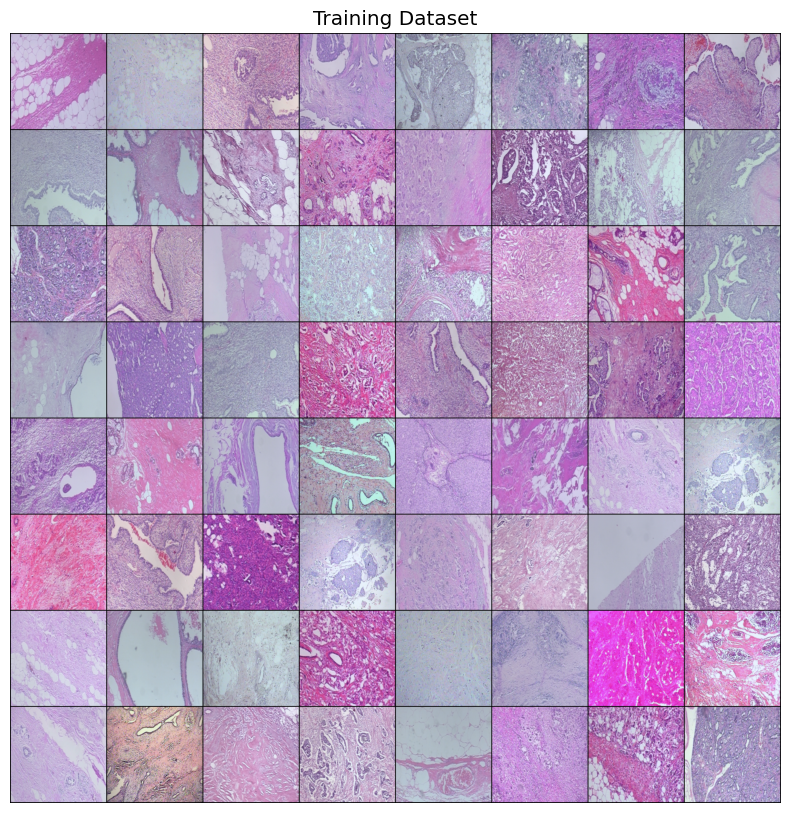

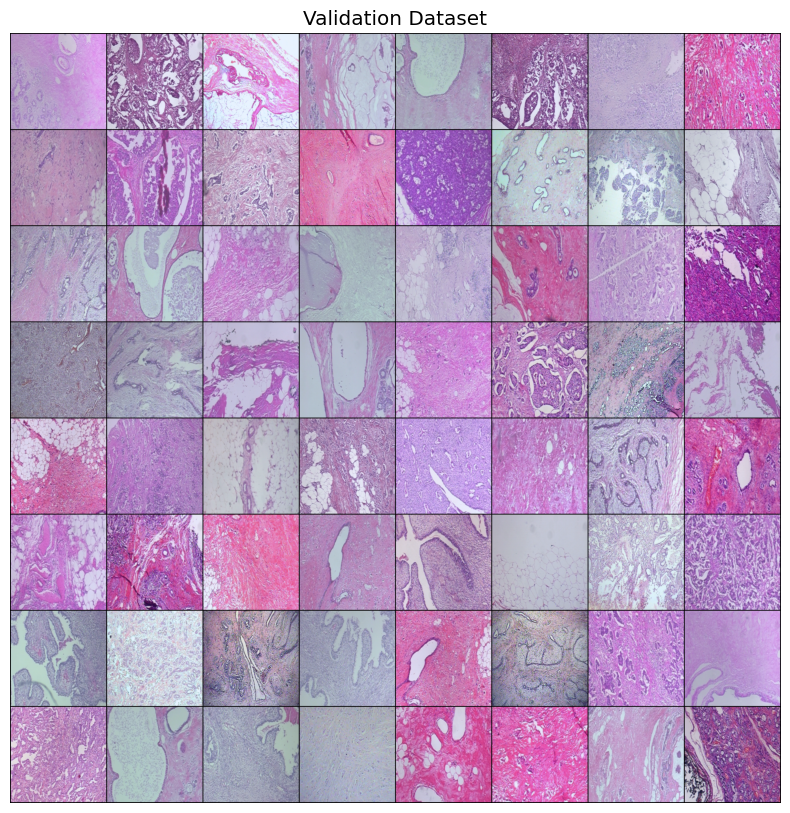

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils

# Function to visualize images from DataLoader
def visualize_images(dataloader, title):
    # Get a batch of images and labels
    images, labels = next(iter(dataloader))
    
    # Make a grid from batch
    grid = vutils.make_grid(images, nrow=8, padding=2, normalize=True)
    
    # Convert PyTorch Tensor to NumPy array and transpose axis to (H, W, C) for matplotlib
    grid_np = np.transpose(grid.numpy(), (1, 2, 0))
    
    # Plotting with matplotlib
    plt.figure(figsize=(20, 10))
    plt.imshow(grid_np)
    plt.title(title)
    plt.axis('off')
    plt.show()

# Visualize images from training dataset
visualize_images(train_loader, title='Training Dataset')

# Visualize images from validation dataset
visualize_images(val_loader, title='Validation Dataset')


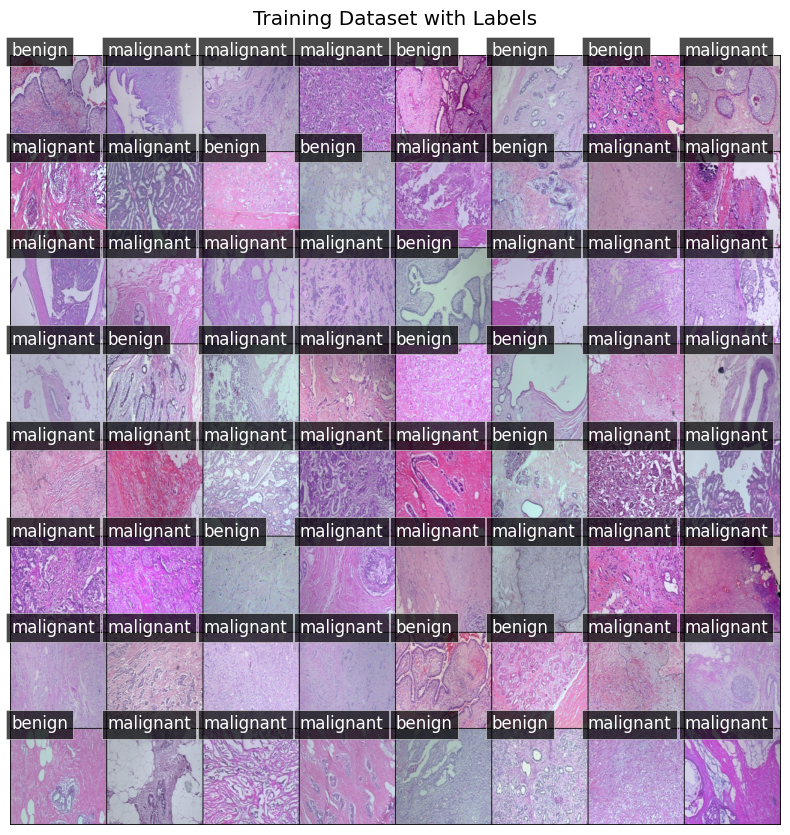

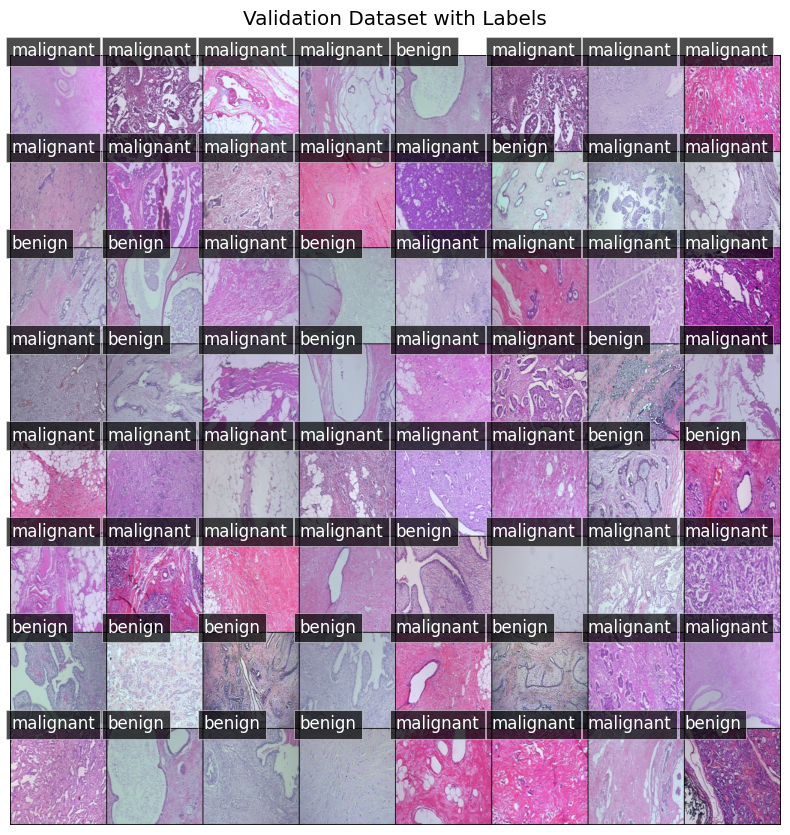

In [7]:
import matplotlib.pyplot as plt
import numpy as np
import torchvision.utils as vutils

# Function to visualize images from DataLoader with label names
def visualize_images_with_labels(dataloader, dataset, title):
    # Get a batch of images and labels
    images, labels = next(iter(dataloader))
    
    # Make a grid from batch
    grid = vutils.make_grid(images, nrow=8, padding=2, normalize=True)
    
    # Convert PyTorch Tensor to NumPy array and transpose axis to (H, W, C) for matplotlib
    grid_np = np.transpose(grid.numpy(), (1, 2, 0))
    
    # Plotting with matplotlib
    plt.figure(figsize=(20, 10))
    plt.imshow(grid_np)
    plt.title(title)
    plt.axis('off')
    
    # Calculate number of images in the batch
    num_images = images.size(0)
    
    # Add label names to the images
    for i in range(num_images):
        label_idx = labels[i].item()
        label_name = dataset.classes[label_idx]
        
        # Calculate position to place the text
        row = i // 8
        col = i % 8
        x = col * (224 + 2) + 2  # 224 is the image width, 2 is the padding
        y = row * (224 + 2) + 2  # 224 is the image height, 2 is the padding
        
        plt.text(x, y, label_name, fontsize=12, color='white', bbox=dict(facecolor='black', alpha=0.7))
    
    plt.show()

# Example usage:
visualize_images_with_labels(train_loader, dataset, title='Training Dataset with Labels\n')
visualize_images_with_labels(val_loader, dataset, title='Validation Dataset with Labels\n')


In [8]:
import math

# Assuming you have already defined your train_dataset and val_dataset
# Get the number of samples in the training and validation datasets
num_train_samples = len(train_dataset)
num_val_samples = len(val_dataset)

# Define your batch size
batch_size = 32

# Calculate the number of batches
num_train_batches = math.ceil(num_train_samples / batch_size)
num_val_batches = math.ceil(num_val_samples / batch_size)

print(f'Number of training samples: {num_train_samples}')
print(f'Number of validation samples: {num_val_samples}')
print(f'Number of training batches: {num_train_batches}')
print(f'Number of validation batches: {num_val_batches}')


Number of training samples: 1596
Number of validation samples: 399
Number of training batches: 50
Number of validation batches: 13


In [9]:
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import dataset
from torchvision import models

# Define the SE Block
class SEBlock(nn.Module):
    def __init__(self, channel, reduction=16):
        super(SEBlock, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Linear(channel, channel // reduction, bias=False),
            nn.ReLU(inplace=True),
            nn.Linear(channel // reduction, channel, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _, _ = x.size()
        y = self.avg_pool(x).view(b, c)
        y = self.fc(y).view(b, c, 1, 1)
        return x * y.expand_as(x)

# Define the Self-Attention Block
class SelfAttention(nn.Module):
    def __init__(self, in_dim):
        super(SelfAttention, self).__init__()
        self.query_conv = nn.Conv2d(in_channels=in_dim, out_channels=in_dim // 8, kernel_size=1)
        self.key_conv = nn.Conv2d(in_channels=in_dim, out_channels=in_dim // 8, kernel_size=1)
        self.value_conv = nn.Conv2d(in_channels=in_dim, out_channels=in_dim, kernel_size=1)
        self.gamma = nn.Parameter(torch.zeros(1))
        self.softmax = nn.Softmax(dim=-1)

    def forward(self, x):
        batch_size, C, width, height = x.size()
        proj_query = self.query_conv(x).view(batch_size, -1, width * height).permute(0, 2, 1)
        proj_key = self.key_conv(x).view(batch_size, -1, width * height)
        energy = torch.bmm(proj_query, proj_key)
        attention = self.softmax(energy)
        proj_value = self.value_conv(x).view(batch_size, -1, width * height)
        out = torch.bmm(proj_value, attention.permute(0, 2, 1))
        out = out.view(batch_size, C, width, height)
        out = self.gamma * out + x
        return out

# Custom ResNet with SE and Self-Attention Blocks
class SEResNet50WithAttention(nn.Module):
    def __init__(self, num_classes):
        super(SEResNet50WithAttention, self).__init__()
        self.model = models.resnet50(pretrained=True)
        self.model.layer1 = self._add_se_and_attention_block(self.model.layer1)
        self.model.layer2 = self._add_se_and_attention_block(self.model.layer2)
        self.model.layer3 = self._add_se_and_attention_block(self.model.layer3)
        self.model.layer4 = self._add_se_and_attention_block(self.model.layer4)
        self.model.fc = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(self.model.fc.in_features, num_classes)
        )

    def _add_se_and_attention_block(self, layer):
        for name, module in layer.named_children():
            if isinstance(module, nn.Sequential):
                new_modules = []
                for sub_name, sub_module in module.named_children():
                    new_modules.append(sub_module)
                    new_modules.append(SEBlock(sub_module.conv3.out_channels))
                    new_modules.append(SelfAttention(sub_module.conv3.out_channels))
                layer._modules[name] = nn.Sequential(*new_modules)
        return layer

    def forward(self, x):
        return self.model(x)

# Instantiate the model
num_classes = len(train_dataset.dataset.classes)
model = SEResNet50WithAttention(num_classes=num_classes)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


C:\Users\mahed\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\mahed\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


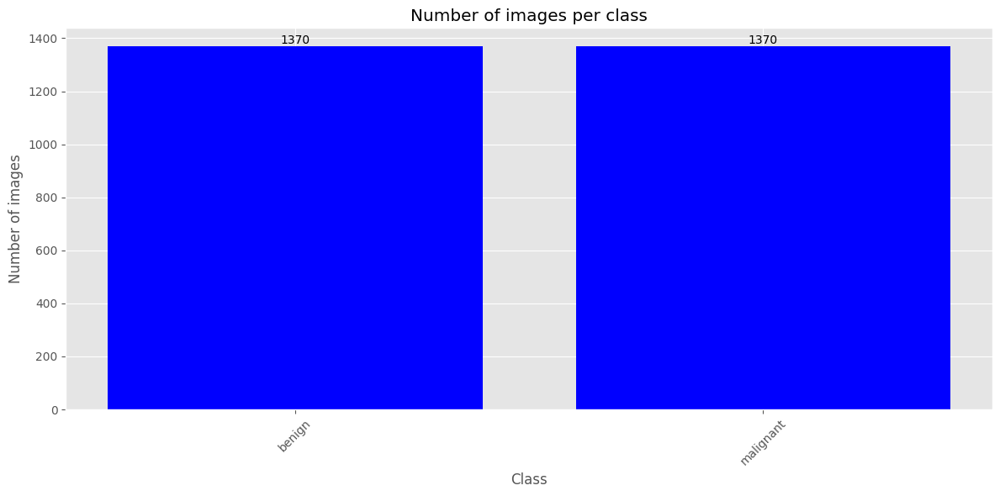

In [10]:
import matplotlib.pyplot as plt
from collections import Counter

# Count the number of images per class in the original dataset
class_counts = Counter()
for _, label in train_dataset.dataset:
    class_counts[label] += 1

# Map class indices to class names using class_to_idx dictionary
class_names = [train_dataset.dataset.classes[idx] for idx in sorted(train_dataset.dataset.class_to_idx.values())]
counts = [class_counts[idx] for idx in sorted(train_dataset.dataset.class_to_idx.values())]

# Plot the number of images per class
plt.figure(figsize=(12, 6))
bars = plt.bar(class_names, counts, color='blue')
plt.xlabel('Class')
plt.ylabel('Number of images')
plt.title('Number of images per class')
plt.xticks(rotation=45)

# Annotate bars with the counts
for bar, count in zip(bars, counts):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), str(count), 
             ha='center', va='bottom')

plt.tight_layout()
plt.show()


In [11]:
# Set device
print(model)
# Define a sample input tensor (replace this with your actual input)
sample_input = torch.randn(1, 3, 256, 256)

# Pass the sample input through the model to get the output
output = model(sample_input)

# Print the shape of the output tensor
print("Output shape:", output.shape)

SEResNet50WithAttention(
  (model): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequenti

In [12]:
import torch

# Check if CUDA is available
train_on_gpu = torch.cuda.is_available()

# Print the result
if train_on_gpu:
    print('CUDA is available! Training on GPU...')
else:
    print('CUDA is not available. Training on CPU...')

CUDA is available! Training on GPU...


In [13]:
# Inside your model creation code, after defining your model
if train_on_gpu:
    model.cuda()

In [14]:
# Trainable Parameters
pytorch_total_params = sum(p.numel() for p in model.parameters() if p.requires_grad)
print("Number of trainable parameters: \n{}".format(pytorch_total_params))

Number of trainable parameters: 
23512130


In [15]:
# Print the model summary
from torchsummary import summary
summary(model, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 256, 56, 56]          16,384
      BatchNorm2d-12          [-1, 256, 56, 56]             512
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [16]:
# check if CUDA is available
train_on_gpu = torch.cuda.is_available()

if train_on_gpu:
    device = torch.device("cuda")          # CUDA device object
    print(f"CUDA is available! Using GPU: {torch.cuda.get_device_name(0)}")
else:
    device = torch.device("cpu")           # CPU device object
    print("CUDA is not available. Using CPU instead.")

CUDA is available! Using GPU: NVIDIA GeForce GTX 1660 SUPER


In [17]:
# Inside your model creation code, after defining your model
if train_on_gpu:
    model.cuda()

In [18]:
# Loss function and optimizer
from torch.optim.lr_scheduler import ReduceLROnPlateau


criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0001)
scheduler = ReduceLROnPlateau(optimizer, 'min', patience=3, factor=0.5, verbose=True)

In [19]:
import torch
import torch.optim as optim
import torch.nn.functional as F
import numpy as np
from sklearn.metrics import roc_auc_score, accuracy_score, precision_score, recall_score, confusion_matrix
from sklearn.preprocessing import OneHotEncoder
import random

# Initialize OneHotEncoder with updated parameter
onehot_encoder = OneHotEncoder(sparse_output=False)

# Check if CUDA is available
train_on_gpu = torch.cuda.is_available()

# Initialize model, criterion, optimizer, scheduler
# Assuming model, criterion, optimizer, scheduler are already defined

# Training loop with evaluation metrics
n_epochs = 100
valid_loss_min = np.Inf

# Keeping track of losses and accuracies
train_losses = []
valid_losses = []
train_accuracies = []
valid_accuracies = []
auc_epoch = []

for epoch in range(1, n_epochs + 1):
    # Keep track of training and validation loss and accuracy
    train_loss = 0.0
    valid_loss = 0.0
    train_correct = 0
    train_total = 0
    val_correct = 0
    val_total = 0
    val_auc_epoch = []
    val_precision_epoch = []
    val_recall_epoch = []
    val_specificity_epoch = []
    
    ###################
    # train the model #
    ###################
    model.train()
    for images, target in train_loader:
        # Move tensors to GPU if CUDA is available
        if train_on_gpu:
            images, target = images.cuda(), target.cuda()
        
        target = target.long()
        # Clear the gradients of all optimized variables
        optimizer.zero_grad()
        # Forward pass: compute predicted outputs by passing inputs to the model
        output = model(images)
        # Calculate the batch loss
        loss = criterion(output, target)
        # Backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # Perform a single optimization step (parameter update)
        optimizer.step()
        # Update Train loss
        train_loss += loss.item() * images.size(0)
        
        # Calculate accuracy
        _, preds = torch.max(output, 1)
        train_correct += (preds == target).sum().item()
        train_total += target.size(0)
    
    ######################    
    # validate the model #
    ######################
    model.eval()
    for images, target in val_loader:
        # Move tensors to GPU if CUDA is available
        if train_on_gpu:
            images, target = images.cuda(), target.cuda()
        
        target = target.long()
        # Forward pass: compute predicted outputs by passing inputs to the model
        output = model(images)
        # Calculate the batch loss
        loss = criterion(output, target)
        # Update average validation loss 
        valid_loss += loss.item() * images.size(0)
        
        # Calculate accuracy
        _, preds = torch.max(output, 1)
        val_correct += (preds == target).sum().item()
        val_total += target.size(0)
        
        # Convert output to probabilities using softmax
        probs = F.softmax(output, dim=1).cpu().detach().numpy()
        # Convert target to numpy array
        y_true = target.cpu().numpy().reshape(-1, 1)
        y_true_onehot = onehot_encoder.fit_transform(y_true)
        # Calculate ROC AUC for multiclass classification
        if y_true_onehot.shape[1] == probs.shape[1]:
            val_auc_epoch.append(roc_auc_score(y_true_onehot, probs, multi_class='ovr'))
        
        # Calculate precision, recall, and specificity
        val_precision_epoch.append(precision_score(y_true, preds.cpu().numpy(), average='macro', zero_division=0))
        val_recall_epoch.append(recall_score(y_true, preds.cpu().numpy(), average='macro', zero_division=0))
        
        cm = confusion_matrix(y_true, preds.cpu().numpy())
        tn = np.diag(cm)
        fp = cm.sum(axis=0) - tn
        fn = cm.sum(axis=1) - tn
        specificity = np.divide(tn, tn + fp, out=np.zeros_like(tn, dtype=float), where=(tn + fp) != 0)
        val_specificity_epoch.append(np.mean(specificity))

    # Calculate average losses and metrics
    train_loss = train_loss / len(train_loader.dataset)
    valid_loss = (valid_loss / len(val_loader.dataset))
    train_accuracy = train_correct / train_total
    valid_accuracy = (val_correct / val_total)
    valid_auc = np.mean(val_auc_epoch)
    valid_precision = np.mean(val_precision_epoch)
    valid_recall = np.mean(val_recall_epoch)
    valid_specificity = np.mean(val_specificity_epoch)
    
    train_losses.append(train_loss)
    valid_losses.append(valid_loss)
    train_accuracies.append(train_accuracy)
    valid_accuracies.append(valid_accuracy)
    auc_epoch.append(valid_auc)
        
    # Print training/validation statistics 
    print(f'Epoch: {epoch} | Training Loss: {train_loss:.6f} | Validation Loss: {valid_loss:.6f} | Training Accuracy: {train_accuracy:.4f} | Validation Accuracy: {valid_accuracy:.4f} | Validation AUC: {valid_auc:.4f} | Precision: {valid_precision:.4f} | Sensitivity: {valid_recall:.4f} | Specificity: {valid_specificity:.4f}')

    ##################
    # Early Stopping #
    ##################
    # Step the scheduler based on validation loss
    scheduler.step(valid_loss)
    # Get the new learning rate
    new_lr = optimizer.param_groups[0]['lr']
    print(f'Learning Rate adjusted to: {new_lr}')
    
    # Check if validation loss decreased, save model if yes
    if valid_loss <= valid_loss_min:
        print(f'Validation loss decreased ({valid_loss_min:.6f} --> {valid_loss:.6f}).  Saving model ...')
        torch.save(model.state_dict(), 'best_model.pt')
        valid_loss_min = valid_loss


Epoch: 1 | Training Loss: 0.289816 | Validation Loss: 0.106062 | Training Accuracy: 0.8659 | Validation Accuracy: 0.9549 | Validation AUC: 0.9969 | Precision: 0.9569 | Sensitivity: 0.9262 | Specificity: 0.9569
Learning Rate adjusted to: 0.0001
Validation loss decreased (inf --> 0.106062).  Saving model ...
Epoch: 2 | Training Loss: 0.035903 | Validation Loss: 0.042065 | Training Accuracy: 0.9906 | Validation Accuracy: 0.9900 | Validation AUC: 0.9991 | Precision: 0.9823 | Sensitivity: 0.9848 | Specificity: 0.9823
Learning Rate adjusted to: 0.0001
Validation loss decreased (0.106062 --> 0.042065).  Saving model ...
Epoch: 3 | Training Loss: 0.006714 | Validation Loss: 0.053825 | Training Accuracy: 0.9981 | Validation Accuracy: 0.9799 | Validation AUC: 0.9980 | Precision: 0.9822 | Sensitivity: 0.9775 | Specificity: 0.9822
Learning Rate adjusted to: 0.0001
Epoch: 4 | Training Loss: 0.003401 | Validation Loss: 0.040158 | Training Accuracy: 1.0000 | Validation Accuracy: 0.9875 | Validation A

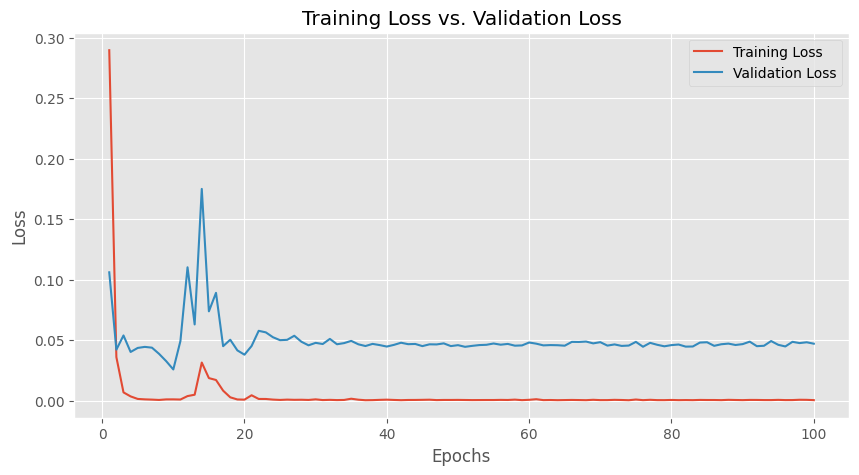

In [20]:
# Plotting the losses
plt.figure(figsize=(10, 5))
plt.plot(range(1, n_epochs + 1), train_losses, label='Training Loss')
plt.plot(range(1, n_epochs + 1), valid_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss vs. Validation Loss')
plt.legend()
plt.show()

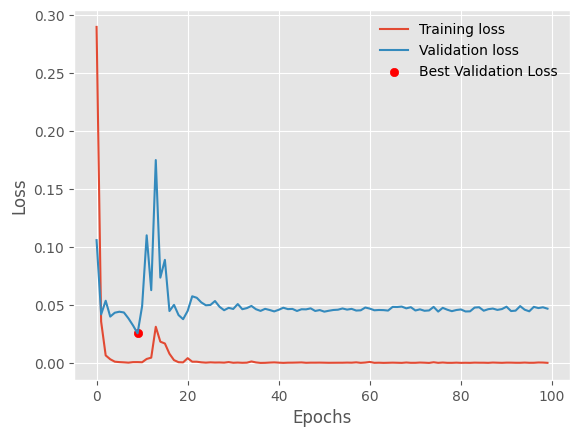

In [21]:
import matplotlib.pyplot as plt

# Assuming 'train_losses' and 'valid_losses' are lists containing training and validation losses for each epoch
# 'best_epoch' is the epoch at which the best validation loss occurred

plt.plot(train_losses, label='Training loss')
plt.plot(valid_losses, label='Validation loss')
plt.xlabel("Epochs")
plt.ylabel("Loss")

# Find the epoch with the minimum validation loss
best_epoch = valid_losses.index(min(valid_losses))

# Plot a marker for the best result
plt.scatter(best_epoch, valid_losses[best_epoch], color='red', label='Best Validation Loss')

plt.legend(frameon=False)
plt.show()


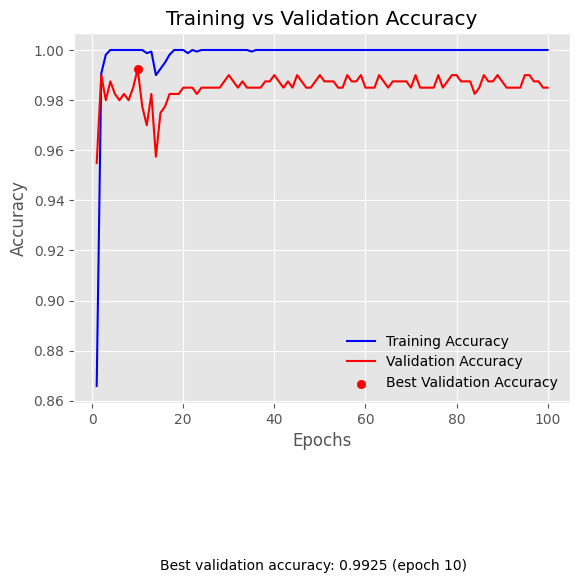

In [22]:
import matplotlib.pyplot as plt

# Number of epochs
epochs = range(1, n_epochs + 1)

# Plotting the data
plt.plot(epochs, train_accuracies, 'b', label='Training Accuracy')
plt.plot(epochs, valid_accuracies, 'r', label='Validation Accuracy')
plt.title('Training vs Validation Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Find the epoch with the best validation accuracy
best_epoch = valid_accuracies.index(max(valid_accuracies)) + 1
best_accuracy = max(valid_accuracies)

# Annotate the plot with the best validation accuracy
plt.scatter(best_epoch, best_accuracy, color='red', label='Best Validation Accuracy')
plt.annotate(f'Best validation accuracy: {best_accuracy:.4f} (epoch {best_epoch})',
             xy=(best_epoch, best_accuracy),
             xytext=(best_epoch + 5, best_accuracy - 0.2)) # Adjust xytext here

plt.legend(frameon=False)

# Display the plot
plt.show()


In [23]:
best_valid_accuracy_percentage = max(valid_accuracies) * 100
print("Best validation accuracy:", best_valid_accuracy_percentage, "%")


Best validation accuracy: 99.24812030075188 %


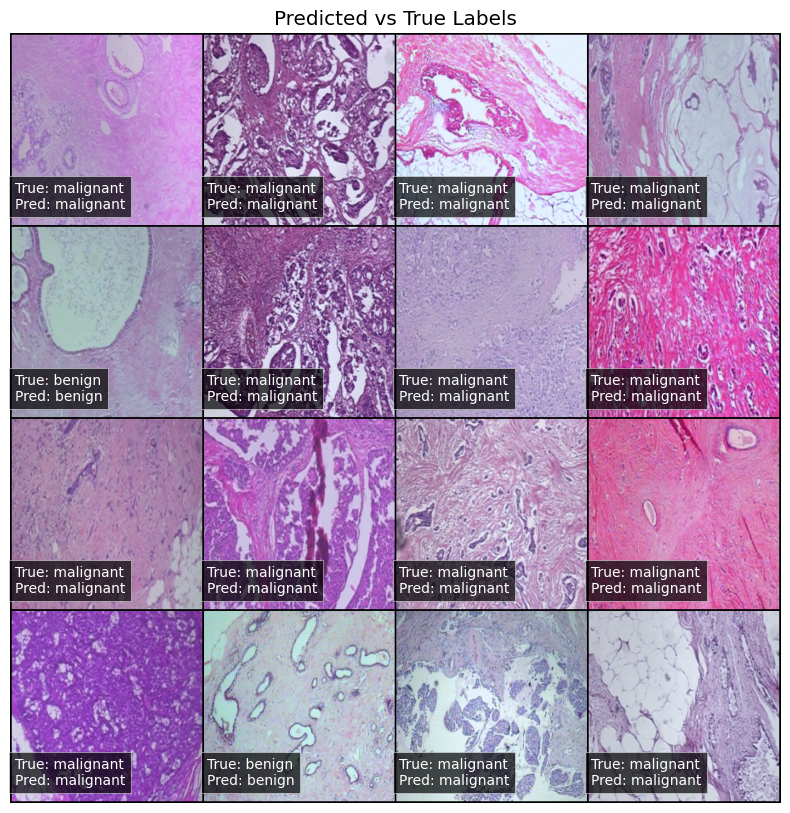

In [24]:
import torch.nn.functional as F

# Function to visualize images with predicted and true labels
def visualize_predictions(dataloader, dataset, model, num_images_to_show=16):
    model.eval()  # Set the model to evaluation mode
    images, true_labels = next(iter(dataloader))
    images = images[:num_images_to_show]
    true_labels = true_labels[:num_images_to_show]

    if train_on_gpu:
        images = images.cuda()

    with torch.no_grad():
        outputs = model(images)
    
    _, predicted_labels = torch.max(outputs, 1)
    images = images.cpu()  # Move images back to CPU for visualization
    
    # Create a grid of images
    grid = vutils.make_grid(images, nrow=4, padding=2, normalize=True)
    grid_np = np.transpose(grid.numpy(), (1, 2, 0))
    
    # Plot the images
    plt.figure(figsize=(20, 10))
    plt.imshow(grid_np)
    plt.title('Predicted vs True Labels')
    plt.axis('off')

    num_images = images.size(0)
    for i in range(num_images):
        true_label_idx = true_labels[i].item()
        predicted_label_idx = predicted_labels[i].item()
        true_label_name = dataset.dataset.classes[true_label_idx]  # Access classes from original dataset
        predicted_label_name = dataset.dataset.classes[predicted_label_idx]
        
        row = i // 4
        col = i % 4
        x = col * (grid_np.shape[1] // 4) + 5
        y = (row + 1) * (grid_np.shape[0] // (num_images // 4)) - 20
        
        plt.text(x, y, f'True: {true_label_name}\nPred: {predicted_label_name}', fontsize=10, color='white', bbox=dict(facecolor='black', alpha=0.7))
    
    plt.show()

# Example usage: Visualize predictions on validation dataset
visualize_predictions(val_loader, val_dataset, model)


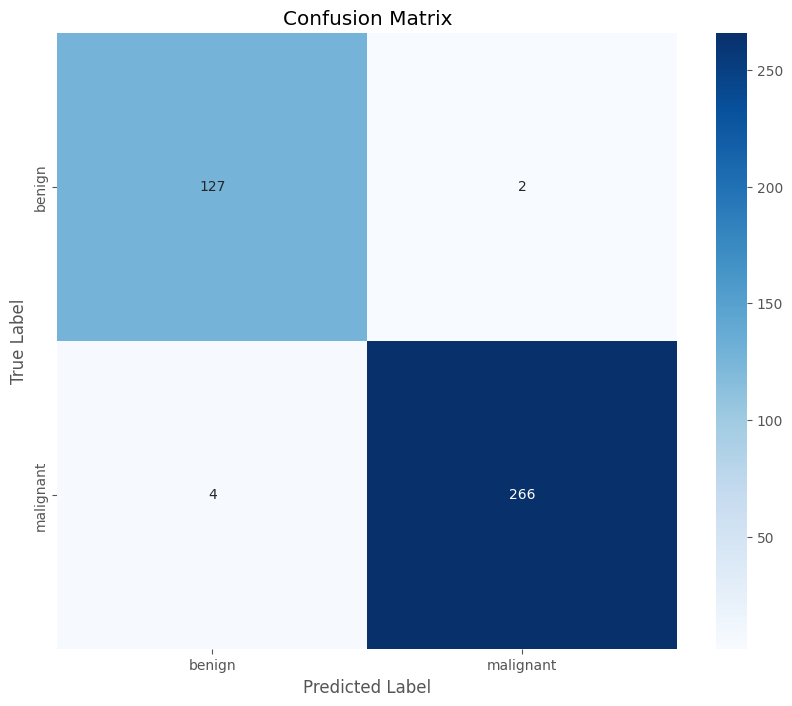

In [25]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

# Function to compute and visualize the confusion matrix
def plot_confusion_matrix(dataloader, model, classes):
    model.eval()  # Set the model to evaluation mode
    
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        for images, labels in dataloader:
            if train_on_gpu:
                images, labels = images.cuda(), labels.cuda()
            
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    # Compute confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    
    # Plot confusion matrix using seaborn
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

# Example usage: Plot confusion matrix for validation dataset
plot_confusion_matrix(val_loader, model, classes=val_dataset.dataset.classes)


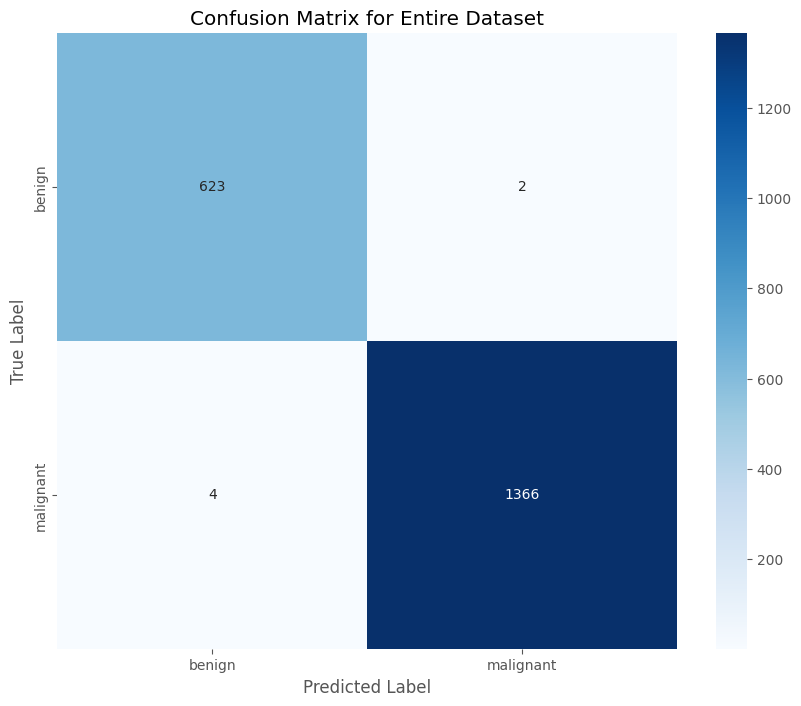

In [26]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

# Function to compute and visualize the confusion matrix for the entire dataset
def plot_confusion_matrix_for_entire_dataset(train_loader, val_loader, model, classes):
    model.eval()  # Set the model to evaluation mode
    
    all_preds = []
    all_labels = []
    
    with torch.no_grad():
        # Iterate over the training dataset
        for images, labels in train_loader:
            if train_on_gpu:
                images, labels = images.cuda(), labels.cuda()
            
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
        
        # Iterate over the validation dataset
        for images, labels in val_loader:
            if train_on_gpu:
                images, labels = images.cuda(), labels.cuda()
            
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
    
    # Compute confusion matrix
    cm = confusion_matrix(all_labels, all_preds)
    
    # Plot confusion matrix using seaborn
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix for Entire Dataset')
    plt.show()

# Example usage: Plot confusion matrix for the entire dataset
plot_confusion_matrix_for_entire_dataset(train_loader, val_loader, model, classes=val_dataset.dataset.classes)


Number of misclassified images: 6
Number of correctly classified images: 1989


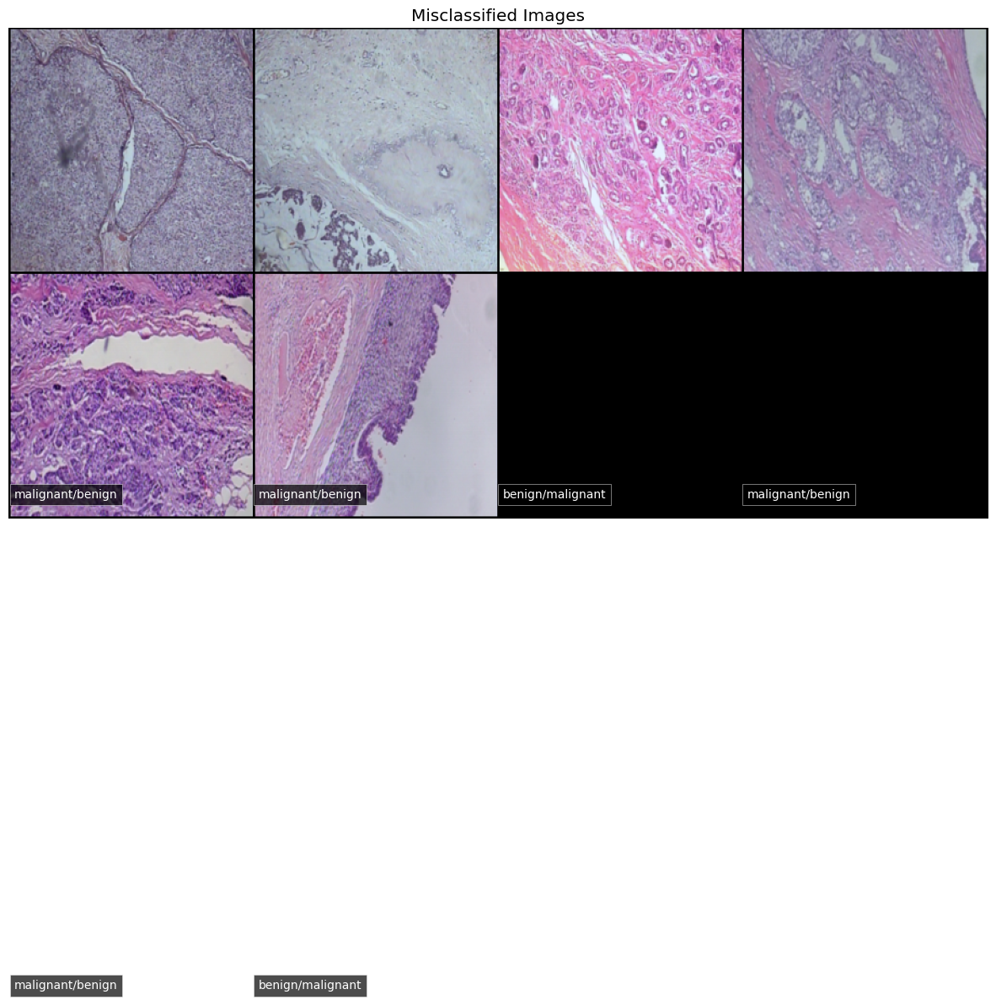

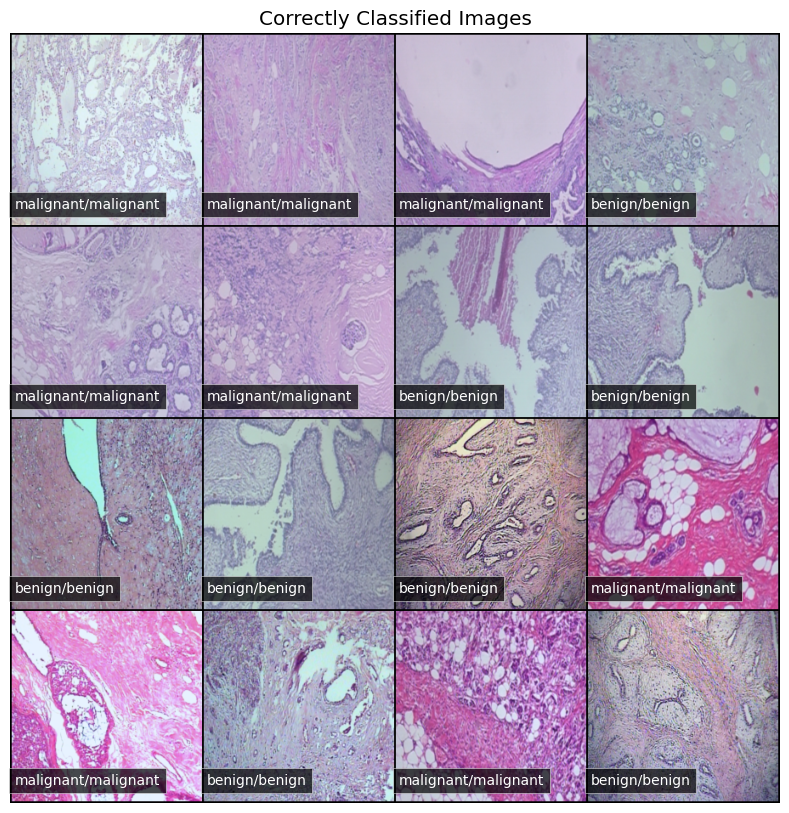

In [27]:
import torch
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt

# Function to collect predictions and labels
def collect_predictions_and_labels(dataloader, model):
    model.eval()  # Set model to evaluation mode
    images_list = []
    preds_list = []
    labels_list = []
    
    with torch.no_grad():
        for images, labels in dataloader:
            if train_on_gpu:
                images, labels = images.cuda(), labels.cuda()
            
            outputs = model(images)
            _, preds = torch.max(outputs, 1)
            
            images_list.extend(images.cpu())
            preds_list.extend(preds.cpu().numpy())
            labels_list.extend(labels.cpu().numpy())
    
    return images_list, preds_list, labels_list

# Function to visualize images
def visualize_images(images, preds, labels, classes, title):
    fig = plt.figure(figsize=(15, 10))
    grid = vutils.make_grid(images, nrow=4, padding=2, normalize=True)
    plt.imshow(np.transpose(grid, (1, 2, 0)))
    plt.title(title)
    plt.axis('off')
    
    for i in range(len(images)):
        label_name = classes[labels[i]]
        pred_name = classes[preds[i]]
        row = i // 4
        col = i % 4
        x = col * (grid.shape[2] // 4) + 5
        y = (row + 1) * (grid.shape[1] // (len(images) // 4)) - 20
        plt.text(x, y, f'{label_name}/{pred_name}', fontsize=10, color='white', bbox=dict(facecolor='black', alpha=0.7))
    
    plt.show()

# Collect predictions and labels for both train and validation loaders
train_images, train_preds, train_labels = collect_predictions_and_labels(train_loader, model)
val_images, val_preds, val_labels = collect_predictions_and_labels(val_loader, model)

# Combine train and validation data
all_images = train_images + val_images
all_preds = train_preds + val_preds
all_labels = train_labels + val_labels

# Identify misclassified and correctly classified images
misclassified_images = []
misclassified_preds = []
misclassified_labels = []
correctly_classified_images = []
correctly_classified_preds = []
correctly_classified_labels = []

for img, pred, label in zip(all_images, all_preds, all_labels):
    if pred == label:
        correctly_classified_images.append(img)
        correctly_classified_preds.append(pred)
        correctly_classified_labels.append(label)
    else:
        misclassified_images.append(img)
        misclassified_preds.append(pred)
        misclassified_labels.append(label)

# Define the classes
classes = val_dataset.dataset.classes

# Print the number of misclassified and correctly classified images
print(f'Number of misclassified images: {len(misclassified_images)}')
print(f'Number of correctly classified images: {len(correctly_classified_images)}')

# Visualize misclassified images
if misclassified_images:
    misclassified_images = misclassified_images[:16]  # Show only first 16 misclassified images
    visualize_images(misclassified_images, misclassified_preds[:16], misclassified_labels[:16], classes, title='Misclassified Images')

# Visualize correctly classified images
if correctly_classified_images:
    correctly_classified_images = correctly_classified_images[:16]  # Show only first 16 correctly classified images
    visualize_images(correctly_classified_images, correctly_classified_preds[:16], correctly_classified_labels[:16], classes, title='Correctly Classified Images')


ROC AUC: 0.999908905109489


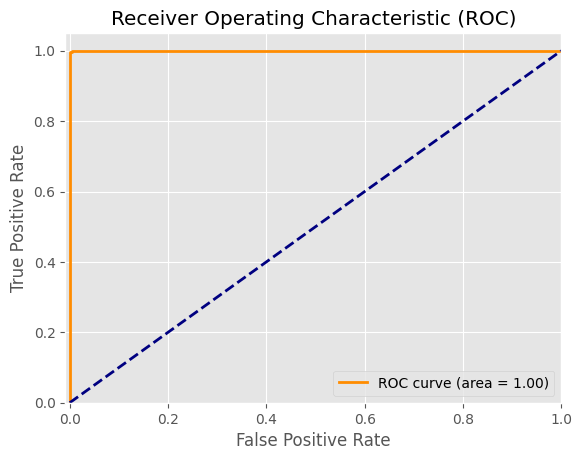

In [32]:
from sklearn.preprocessing import LabelBinarizer
from sklearn.metrics import roc_curve, auc
import numpy as np

# Assuming `all_labels` is your true labels and `all_outputs` is the model predictions
# all_labels should be of shape (n_samples,)
# all_outputs should be of shape (n_samples,)

# Binarize the labels
lb = LabelBinarizer()
all_labels_binarized = lb.fit_transform(all_labels)

# If the labels are not binary, all_labels_binarized will be of shape (n_samples, 1)
# We need it to be (n_samples, 2) for binary classification
if all_labels_binarized.shape[1] == 1:
    all_labels_binarized = np.hstack((1 - all_labels_binarized, all_labels_binarized))

# Check the shape of all_outputs and adjust if necessary
# Assuming `all_outputs` are probabilities for the positive class
# Convert to a 2D array where the first column is the probability of class 0 (1 - probability of class 1)
# and the second column is the probability of class 1 (given by `all_outputs`)
if all_outputs.ndim == 1:
    all_outputs = np.vstack((1 - all_outputs, all_outputs)).T

# Compute ROC curve and ROC area for the positive class
fpr, tpr, _ = roc_curve(all_labels_binarized[:, 1], all_outputs[:, 1])
roc_auc = auc(fpr, tpr)

# Print or plot the ROC curve and AUC
print("ROC AUC:", roc_auc)

# Example of plotting the ROC curve (optional)
import matplotlib.pyplot as plt

plt.figure()
plt.plot(fpr, tpr, color='darkorange', lw=2, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([-0.009, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()
